# Packages 


In [80]:
# base
#------------------------------------
import gc
import plotly.express as px
import pandas as pd  # linear algebra
import numpy as np  # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as plt  # visuals
import seaborn as sns  # visuals
from warnings import simplefilter
import statsmodels.api as sm #PACF & ACF
simplefilter('ignore')  # ignore warnings to clean up output cells


# Imports

In [81]:
train = pd.read_csv('train.csv')
test = pd.read_csv('test.csv')

stores = pd.read_csv('stores.csv')
oil = pd.read_csv('oil.csv')
holidays = pd.read_csv('holidays_events.csv')
transactions = pd.read_csv('transactions.csv')

#Datetime
train['date'] = pd.to_datetime(train.date)
test['date'] = pd.to_datetime(test.date)
transactions['date'] = pd.to_datetime(transactions.date)

#Datatypes
train.onpromotion = train.onpromotion.astype('float16')
train.sales = train.sales.astype('float32')
stores.cluster = stores.cluster.astype('int8')


train.head()


,id,date,store_nbr,family,sales,onpromotion
0,0,2013-01-01,1,AUTOMOTIVE,0.0,0.0
1,1,2013-01-01,1,BABY CARE,0.0,0.0
2,2,2013-01-01,1,BEAUTY,0.0,0.0
3,3,2013-01-01,1,BEVERAGES,0.0,0.0
4,4,2013-01-01,1,BOOKS,0.0,0.0


# Transactions

### Correlation with sales

In [82]:
tr_tr = pd.merge(train.groupby(['date', 'store_nbr']).sales.sum().reset_index(), transactions, how = 'left')
cor = tr_tr['sales'].corr(tr_tr['transactions'])

print('Correlation between sales and transactions is:', cor)


Correlation between sales and transactions is: 0.8373836801236636


In [83]:
px.scatter(tr_tr, x='transactions', y='sales', trendline='ols', trendline_color_override='red')


### Correlation with dates

In [84]:
px.line(transactions.sort_values(['store_nbr', 'date']), x='date', y='transactions', color='store_nbr',title = 'Transactions' )

As we can see there is a seasonal trend that in December spice in sales occurs. 

In [85]:
a = transactions.set_index('date').resample('M').transactions.mean().reset_index()
a['year'] = a.date.dt.year
px.line(a, x='date', y='transactions', color='year',title = 'Monthly Average Transactions' )

### Correlation with Day of Week

We can see that from Friday to Saturday there is a strong growing purchasing trend. However, on Sundays people tend to start minimising the number of purchases.

In [86]:
a = transactions.copy()
a['year'] = a.date.dt.year
a['dayofweek'] = a.date.dt.dayofweek+1
a = a.groupby(['year', 'dayofweek']).transactions.mean().reset_index()
px.line(a, x='dayofweek', y='transactions', color='year', title='Transactions')


# Oil Analysis

### Oil data

In [87]:
# There are some missing values so we will need to intrapolate them 



oil['date'] = pd.to_datetime(oil.date)
oil = oil.set_index('date').dcoilwtico.resample('D').sum().reset_index()
oil['dcoilwtico'] = np.where(oil['dcoilwtico'] == 0, np.nan, oil['dcoilwtico'])
oil['dcoilwtico_interpol'] = oil.dcoilwtico.interpolate()

p = oil.melt(id_vars=['date']+list(oil.keys()[5:]), var_name='Legend')
px.line(p.sort_values(['Legend', 'date'], ascending=[False, True]),
        x='date', y='value', color='Legend', title='Daily Oil Price')


Correlation with Daily Oil Prices
sales          -0.303237
transactions    0.040105
Name: dcoilwtico_interpolated, dtype: float64 



Text(0.5, 1.0, 'Daily Oil Price & Sales')

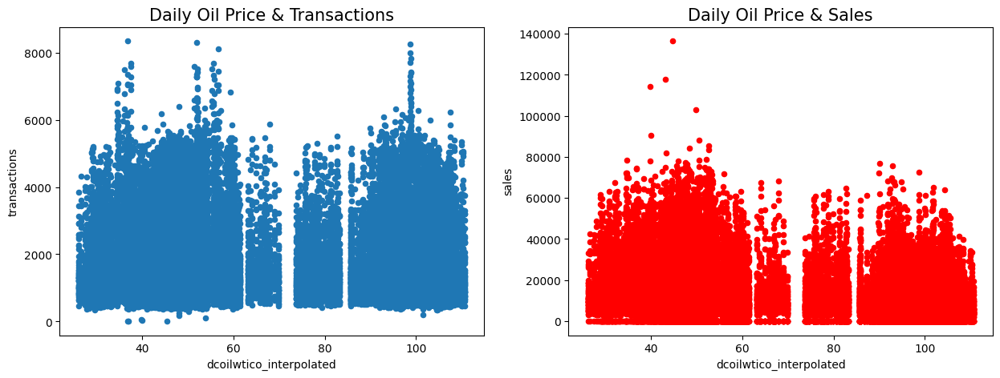

In [88]:
temp = pd.merge(tr_tr, oil, how='left')
print('Correlation with Daily Oil Prices')
print(temp.drop(['store_nbr', 'dcoilwtico'], axis=1).corr(
    'spearman').dcoilwtico_interpolated.loc[['sales', 'transactions']], '\n')


fig, axes = plt.subplots(1, 2, figsize=(15, 5))
temp.plot.scatter(x='dcoilwtico_interpolated', y='transactions', ax=axes[0])
temp.plot.scatter(x='dcoilwtico_interpolated', y='sales', ax=axes[1], color='r')
axes[0].set_title('Daily Oil Price & Transactions', fontsize=15)
axes[1].set_title('Daily Oil Price & Sales', fontsize=15)


Let's draw a scatter plot but let's pay attention for product families this time. All of the plots almost contains same pattern. When daily oil price is under about 70, there are more sales in the data. There are 2 cluster here. They are over 70 and under 70. It seems pretty understandable actually.

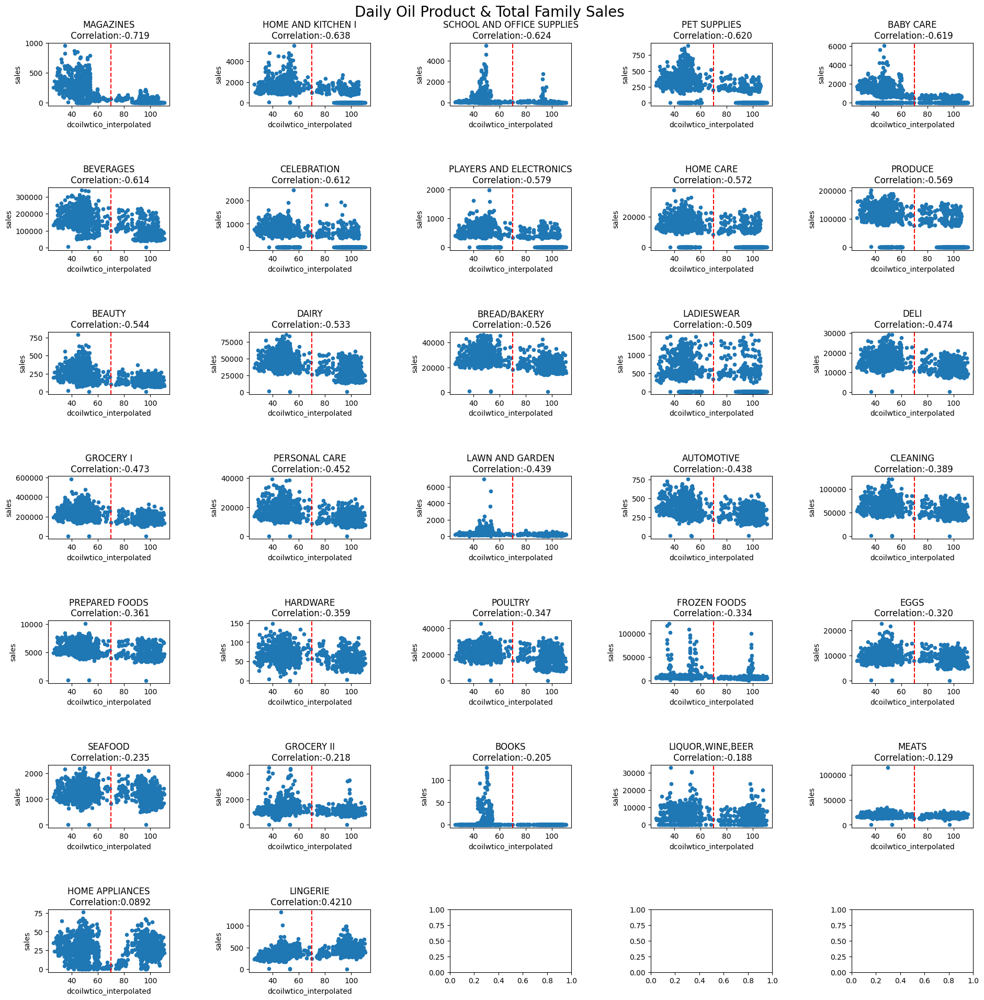

In [89]:
a = pd.merge(train.groupby(['date', 'family']).sales.sum(
).reset_index(), oil.drop('dcoilwtico', axis=1), how='left')
c = a.groupby('family').corr('spearman').reset_index()
c = c[c.level_1 == 'dcoilwtico_interpolated'][[
    'family', 'sales']].sort_values('sales')

fig, axes = plt.subplots(7, 5, figsize=(20, 20))
for i, fam in enumerate(c.family):
    if i < 6:
        a[a.family == fam].plot.scatter(
            x='dcoilwtico_interpolated', y='sales', ax=axes[0, i-1])
        axes[0, i-1].set_title(fam+'\n Correlation:' +
                                str(c[c.family == fam].sales.iloc[0])[:6], fontsize=12)
        axes[0, i-1].axvline(x=70, color='r', linestyle='--')
    if i >= 6 and i < 11:
        a[a.family == fam].plot.scatter(
            x='dcoilwtico_interpolated', y='sales', ax=axes[1, i-6])
        axes[1, i-6].set_title(fam+'\n Correlation:' +
                                str(c[c.family == fam].sales.iloc[0])[:6], fontsize=12)
        axes[1, i-6].axvline(x=70, color='r', linestyle='--')
    if i >= 11 and i < 16:
        a[a.family == fam].plot.scatter(
            x='dcoilwtico_interpolated', y='sales', ax=axes[2, i-11])
        axes[2, i-11].set_title(fam+'\n Correlation:' +
                                str(c[c.family == fam].sales.iloc[0])[:6], fontsize=12)
        axes[2, i-11].axvline(x=70, color='r', linestyle='--')
    if i >= 16 and i < 21:
        a[a.family == fam].plot.scatter(
            x='dcoilwtico_interpolated', y='sales', ax=axes[3, i-16])
        axes[3, i-16].set_title(fam+'\n Correlation:' +
                                str(c[c.family == fam].sales.iloc[0])[:6], fontsize=12)
        axes[3, i-16].axvline(x=70, color='r', linestyle='--')
    if i >= 21 and i < 26:
        a[a.family == fam].plot.scatter(
            x='dcoilwtico_interpolated', y='sales', ax=axes[4, i-21])
        axes[4, i-21].set_title(fam+'\n Correlation:' +
                                str(c[c.family == fam].sales.iloc[0])[:6], fontsize=12)
        axes[4, i-21].axvline(x=70, color='r', linestyle='--')
    if i >= 26 and i < 31:
        a[a.family == fam].plot.scatter(
            x='dcoilwtico_interpolated', y='sales', ax=axes[5, i-26])
        axes[5, i-26].set_title(fam+'\n Correlation:' +
                                str(c[c.family == fam].sales.iloc[0])[:6], fontsize=12)
        axes[5, i-26].axvline(x=70, color='r', linestyle='--')
    if i >= 31:
        a[a.family == fam].plot.scatter(
            x='dcoilwtico_interpolated', y='sales', ax=axes[6, i-31])
        axes[6, i-31].set_title(fam+'\n Correlation:' +
                                str(c[c.family == fam].sales.iloc[0])[:6], fontsize=12)
        axes[6, i-31].axvline(x=70, color='r', linestyle='--')


plt.tight_layout(pad=5)
plt.suptitle('Daily Oil Product & Total Family Sales \n', fontsize=20)
plt.show()


# Sales

### Daily total sales of the stores

In [90]:
a = train.set_index('date').groupby(
    'store_nbr').resample('D').sales.sum().reset_index()
px.line(a, x='date', y='sales', color='store_nbr',
        title='Daily total sales of the stores')


In [91]:
# Getting rid of the stores with no sales at the beggining of 2013

print(train.shape)
train = train[~((train.store_nbr == 52) & (train.date < '2017-04-20'))]
train = train[~((train.store_nbr == 22) & (train.date < '2015-10-09'))]
train = train[~((train.store_nbr == 42) & (train.date < '2015-08-21'))]
train = train[~((train.store_nbr == 21) & (train.date < '2015-07-24'))]
train = train[~((train.store_nbr == 29) & (train.date < '2015-03-20'))]
train = train[~((train.store_nbr == 20) & (train.date < '2015-02-13'))]
train = train[~((train.store_nbr == 53) & (train.date < '2014-05-29'))]
train = train[~((train.store_nbr == 36) & (train.date < '2013-05-09'))]
train.shape


(3000888, 6)


(2780316, 6)

### Zero forecasting

We can see which products aren't sold in which stores using the code below.

In [92]:
c = train.groupby(['store_nbr', 'family']).sales.sum(
).reset_index().sort_values(['family', 'store_nbr'])
c = c[c.sales == 0]
c


,store_nbr,family,sales
1,1,BABY CARE,0.0
397,13,BABY CARE,0.0
727,23,BABY CARE,0.0
1420,44,BABY CARE,0.0
1453,45,BABY CARE,0.0
1486,46,BABY CARE,0.0
1519,47,BABY CARE,0.0
1552,48,BABY CARE,0.0
1585,49,BABY CARE,0.0
1618,50,BABY CARE,0.0


In [93]:
print(train.shape)
# Anti Join
outer_join = train.merge(c[c.sales == 0].drop(
    'sales', axis=1), how='outer', indicator=True)
train = outer_join[~(outer_join._merge == 'both')].drop('_merge', axis=1)
del outer_join
gc.collect()
train.shape


(2780316, 6)


(2698648, 6)

In [94]:
zero_prediction = []
for i in range(0, len(c)):
    zero_prediction.append(
        pd.DataFrame({
            'date': pd.date_range('2017-08-16', '2017-08-31').tolist(),
            'store_nbr': c.store_nbr.iloc[i],
            'family': c.family.iloc[i],
            'sales': 0
        })
    )
zero_prediction = pd.concat(zero_prediction)
del c
gc.collect()
zero_prediction


,date,store_nbr,family,sales
0,2017-08-16,1,BABY CARE,0
1,2017-08-17,1,BABY CARE,0
2,2017-08-18,1,BABY CARE,0
3,2017-08-19,1,BABY CARE,0
4,2017-08-20,1,BABY CARE,0
...,...,...,...,...
11,2017-08-27,54,LAWN AND GARDEN,0
12,2017-08-28,54,LAWN AND GARDEN,0
13,2017-08-29,54,LAWN AND GARDEN,0
14,2017-08-30,54,LAWN AND GARDEN,0


### Are product families active or passive?

Since some products can be sold more rarely than others, we should investigate the last 60 days. However, some product families depends on seasonality. Some of them might not active on the last 60 days but it doesn't mean it is passive.

In [95]:
c = train.groupby(['family', 'store_nbr']).tail(60).groupby(
    ['family', 'store_nbr']).sales.sum().reset_index()
c[c.sales == 0]


,family,store_nbr,sales
54,BABY CARE,2,0.0
62,BABY CARE,10,0.0
64,BABY CARE,12,0.0
65,BABY CARE,14,0.0
76,BABY CARE,26,0.0
82,BABY CARE,32,0.0
83,BABY CARE,33,0.0
87,BABY CARE,37,0.0
88,BABY CARE,38,0.0
92,BABY CARE,42,0.0


Here will create a new feature. It shows that the product family is active or not .


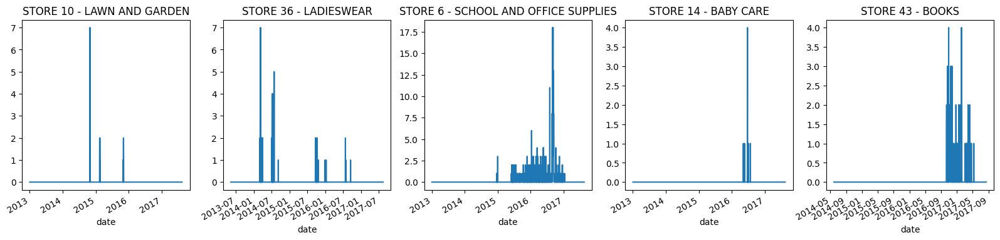

In [96]:
fig, ax = plt.subplots(1, 5, figsize=(20, 4))
train[(train.store_nbr == 10) & (train.family == 'LAWN AND GARDEN')].set_index(
    'date').sales.plot(ax=ax[0], title='STORE 10 - LAWN AND GARDEN')
train[(train.store_nbr == 36) & (train.family == 'LADIESWEAR')].set_index(
    'date').sales.plot(ax=ax[1], title='STORE 36 - LADIESWEAR')
train[(train.store_nbr == 6) & (train.family == 'SCHOOL AND OFFICE SUPPLIES')].set_index(
    'date').sales.plot(ax=ax[2], title='STORE 6 - SCHOOL AND OFFICE SUPPLIES')
train[(train.store_nbr == 14) & (train.family == 'BABY CARE')].set_index(
    'date').sales.plot(ax=ax[3], title='STORE 14 - BABY CARE')
train[(train.store_nbr == 53) & (train.family == 'BOOKS')].set_index(
    'date').sales.plot(ax=ax[4], title='STORE 43 - BOOKS')
plt.show()


In [97]:
a = train.set_index('date').groupby(
    'family').resample('D').sales.sum().reset_index()
px.line(a, x='date', y='sales', color='family',
        title='Daily total sales of the family')

Lets show the most selling product families.

In [98]:
a = train.groupby('family').sales.mean().sort_values(
    ascending=False).reset_index()
px.bar(a, y='family', x='sales', color='family',
       title='Which product family preferred more?')


In [99]:
print('Correlation between Sales and Onpromotion: {:,.4f}'.format(
    train.corr('spearman').sales.loc['onpromotion']))


Correlation between Sales and Onpromotion: 0.5304


# Holidays and Events

### Our main problems:
1. Some national holidays have been transferred.
2. There might be a few holidays in one day. When we merged all of data, number of rows might increase. We don't want duplicates.
3. What is the scope of holidays? It can be regional or national or local. You need to split them by the scope.
4. Work day issue
5. Some specific events
6. Creating new features etc.

In [102]:
holidays['date'] = pd.to_datetime(holidays.date)

# Transferred Holidays
tr1 = holidays[(holidays.type == 'Holiday') & (holidays.transferred == True)].drop(
    'transferred', axis=1).reset_index(drop=True)
tr2 = holidays[(holidays.type == 'Transfer')].drop(
    'transferred', axis=1).reset_index(drop=True)
tr = pd.concat([tr1, tr2], axis=1)
tr = tr.iloc[:, [5, 1, 2, 3, 4]]

holidays = holidays[(holidays.transferred == False) & (
    holidays.type != 'Transfer')].drop('transferred', axis=1)
holidays = holidays.append(tr).reset_index(drop=True)


# Additional Holidays
holidays['description'] = holidays['description'].str.replace(
    '-', '').str.replace('+', '').str.replace('\d+', '')
holidays['type'] = np.where(
    holidays['type'] == 'Additional', 'Holiday', holidays['type'])

# Bridge Holidays
holidays['description'] = holidays['description'].str.replace('Puente ', '')
holidays['type'] = np.where(
    holidays['type'] == 'Bridge', 'Holiday', holidays['type'])


# Work Day Holidays, that is meant to payback the Bridge.
work_day = holidays[holidays.type == 'Work Day']
holidays = holidays[holidays.type != 'Work Day']


# Split

# Events are national
events = holidays[holidays.type == 'Event'].drop(
    ['type', 'locale', 'locale_name'], axis=1).rename({'description': 'events'}, axis=1)

holidays = holidays[holidays.type != 'Event'].drop('type', axis=1)
regional = holidays[holidays.locale == 'Regional'].rename(
    {'locale_name': 'state', 'description': 'holiday_regional'}, axis=1).drop('locale', axis=1).drop_duplicates()
national = holidays[holidays.locale == 'National'].rename(
    {'description': 'holiday_national'}, axis=1).drop(['locale', 'locale_name'], axis=1).drop_duplicates()
local = holidays[holidays.locale == 'Local'].rename(
    {'description': 'holiday_local', 'locale_name': 'city'}, axis=1).drop('locale', axis=1).drop_duplicates()


d = pd.merge(train.append(test), stores)
d['store_nbr'] = d['store_nbr'].astype('int8')


# National Holidays & Events
#d = pd.merge(d, events, how = 'left')
d = pd.merge(d, national, how='left')
# Regional
d = pd.merge(d, regional, how='left', on=['date', 'state'])
# Local
d = pd.merge(d, local, how='left', on=['date', 'city'])

# Work Day: It will be removed when real work day colum created
d = pd.merge(d,  work_day[['date', 'type']].rename(
    {'type': 'IsWorkDay'}, axis=1), how='left')

# EVENTS
events['events'] = np.where(events.events.str.contains(
    'futbol'), 'Futbol', events.events)


def one_hot_encoder(df, nan_as_category=True):
    original_columns = list(df.columns)
    categorical_columns = df.select_dtypes(
        ['category', 'object']).columns.tolist()
    # categorical_columns = [col for col in df.columns if df[col].dtype == 'object']
    df = pd.get_dummies(df, columns=categorical_columns,
                        dummy_na=nan_as_category)
    new_columns = [c for c in df.columns if c not in original_columns]
    df.columns = df.columns.str.replace(' ', '_')
    return df, df.columns.tolist()


events, events_cat = one_hot_encoder(events, nan_as_category=False)
events['events_Dia_de_la_Madre'] = np.where(
    events.date == '2016-05-08', 1, events['events_Dia_de_la_Madre'])
events = events.drop(239)

d = pd.merge(d, events, how='left')
d[events_cat] = d[events_cat].fillna(0)

# New features
d['holiday_national_binary'] = np.where(d.holiday_national.notnull(), 1, 0)
d['holiday_local_binary'] = np.where(d.holiday_local.notnull(), 1, 0)
d['holiday_regional_binary'] = np.where(d.holiday_regional.notnull(), 1, 0)

#
d['national_independence'] = np.where(d.holiday_national.isin(['Batalla de Pichincha',  'Independencia de Cuenca',
                                      'Independencia de Guayaquil', 'Independencia de Guayaquil', 'Primer Grito de Independencia']), 1, 0)
d['local_cantonizacio'] = np.where(
    d.holiday_local.str.contains('Cantonizacio'), 1, 0)
d['local_fundacion'] = np.where(
    d.holiday_local.str.contains('Fundacion'), 1, 0)
d['local_independencia'] = np.where(
    d.holiday_local.str.contains('Independencia'), 1, 0)


holidays, holidays_cat = one_hot_encoder(
    d[['holiday_national', 'holiday_regional', 'holiday_local']], nan_as_category=False)
d = pd.concat([d.drop(['holiday_national', 'holiday_regional',
              'holiday_local'], axis=1), holidays], axis=1)

he_cols = d.columns[d.columns.str.startswith('events')].tolist() + d.columns[d.columns.str.startswith('holiday')].tolist(
) + d.columns[d.columns.str.startswith('national')].tolist() + d.columns[d.columns.str.startswith('local')].tolist()
d[he_cols] = d[he_cols].astype('int8')

d[['family', 'city', 'state', 'type']] = d[[
    'family', 'city', 'state', 'type']].astype('category')

del holidays, holidays_cat, work_day, local, regional, national, events, events_cat, tr, tr1, tr2, he_cols
gc.collect()

d.head(10)


,id,date,store_nbr,family,sales,onpromotion,city,state,type,cluster,...,holiday_local_Fundacion_de_Ibarra,holiday_local_Fundacion_de_Loja,holiday_local_Fundacion_de_Machala,holiday_local_Fundacion_de_Manta,holiday_local_Fundacion_de_Quito,holiday_local_Fundacion_de_Riobamba,holiday_local_Fundacion_de_Santo_Domingo,holiday_local_Independencia_de_Ambato,holiday_local_Independencia_de_Guaranda,holiday_local_Independencia_de_Latacunga
0,0,2013-01-01,1,AUTOMOTIVE,0.0,0.0,Quito,Pichincha,D,13,...,0,0,0,0,0,0,0,0,0,0
1,1782,2013-01-02,1,AUTOMOTIVE,2.0,0.0,Quito,Pichincha,D,13,...,0,0,0,0,0,0,0,0,0,0
2,3564,2013-01-03,1,AUTOMOTIVE,3.0,0.0,Quito,Pichincha,D,13,...,0,0,0,0,0,0,0,0,0,0
3,5346,2013-01-04,1,AUTOMOTIVE,3.0,0.0,Quito,Pichincha,D,13,...,0,0,0,0,0,0,0,0,0,0
4,7128,2013-01-05,1,AUTOMOTIVE,5.0,0.0,Quito,Pichincha,D,13,...,0,0,0,0,0,0,0,0,0,0
5,8910,2013-01-06,1,AUTOMOTIVE,2.0,0.0,Quito,Pichincha,D,13,...,0,0,0,0,0,0,0,0,0,0
6,10692,2013-01-07,1,AUTOMOTIVE,0.0,0.0,Quito,Pichincha,D,13,...,0,0,0,0,0,0,0,0,0,0
7,12474,2013-01-08,1,AUTOMOTIVE,2.0,0.0,Quito,Pichincha,D,13,...,0,0,0,0,0,0,0,0,0,0
8,14256,2013-01-09,1,AUTOMOTIVE,2.0,0.0,Quito,Pichincha,D,13,...,0,0,0,0,0,0,0,0,0,0
9,16038,2013-01-10,1,AUTOMOTIVE,2.0,0.0,Quito,Pichincha,D,13,...,0,0,0,0,0,0,0,0,0,0


We can apply A/B test to Events and Holidays feature. Are they statistically significant? Also it can be a good way for first feature selection.

> H0: The sales are equal (M1 = M2)

> H1: The sales are not equal (M1 != M2)

In [103]:
def AB_Test(dataframe, group, target):
    
    # Packages
    from scipy.stats import shapiro
    import scipy.stats as stats
    
    # Split A/B
    groupA = dataframe[dataframe[group] == 1][target]
    groupB = dataframe[dataframe[group] == 0][target]
    
    # Assumption: Normality
    ntA = shapiro(groupA)[1] < 0.05
    ntB = shapiro(groupB)[1] < 0.05
    # H0: Distribution is Normal! - False
    # H1: Distribution is not Normal! - True
    
    if (ntA == False) & (ntB == False): # 'H0: Normal Distribution'
        # Parametric Test
        # Assumption: Homogeneity of variances
        leveneTest = stats.levene(groupA, groupB)[1] < 0.05
        # H0: Homogeneity: False
        # H1: Heterogeneous: True
        
        if leveneTest == False:
            # Homogeneity
            ttest = stats.ttest_ind(groupA, groupB, equal_var=True)[1]
            # H0: M1 == M2 - False
            # H1: M1 != M2 - True
        else:
            # Heterogeneous
            ttest = stats.ttest_ind(groupA, groupB, equal_var=False)[1]
            # H0: M1 == M2 - False
            # H1: M1 != M2 - True
    else:
        # Non-Parametric Test
        ttest = stats.mannwhitneyu(groupA, groupB)[1] 
        # H0: M1 == M2 - False
        # H1: M1 != M2 - True
        
    # Result
    temp = pd.DataFrame({
        'AB Hypothesis':[ttest < 0.05], 
        'p-value':[ttest]
    })
    temp['Test Type'] = np.where((ntA == False) & (ntB == False), 'Parametric', 'Non-Parametric')
    temp['AB Hypothesis'] = np.where(temp['AB Hypothesis'] == False, 'Fail to Reject H0', 'Reject H0')
    temp['Comment'] = np.where(temp['AB Hypothesis'] == 'Fail to Reject H0', 'A/B groups are similar!', 'A/B groups are not similar!')
    temp['Feature'] = group
    temp['GroupA_mean'] = groupA.mean()
    temp['GroupB_mean'] = groupB.mean()
    temp['GroupA_median'] = groupA.median()
    temp['GroupB_median'] = groupB.median()
    
    # Columns
    if (ntA == False) & (ntB == False):
        temp['Homogeneity'] = np.where(leveneTest == False, 'Yes', 'No')
        temp = temp[['Feature','Test Type', 'Homogeneity','AB Hypothesis', 'p-value', 'Comment', 'GroupA_mean', 'GroupB_mean', 'GroupA_median', 'GroupB_median']]
    else:
        temp = temp[['Feature','Test Type','AB Hypothesis', 'p-value', 'Comment', 'GroupA_mean', 'GroupB_mean', 'GroupA_median', 'GroupB_median']]
    
    # Print Hypothesis
    # print('# A/B Testing Hypothesis')
    # print('H0: A == B')
    # print('H1: A != B', '\n')
    
    return temp
    
# Apply A/B Testing
he_cols = d.columns[d.columns.str.startswith('events')].tolist() + d.columns[d.columns.str.startswith('holiday')].tolist() + d.columns[d.columns.str.startswith('national')].tolist()+ d.columns[d.columns.str.startswith('local')].tolist()
ab = []
for i in he_cols:
    ab.append(AB_Test(dataframe=d[d.sales.notnull()], group = i, target = 'sales'))
ab = pd.concat(ab)
ab

,Feature,Test Type,AB Hypothesis,p-value,Comment,GroupA_mean,GroupB_mean,GroupA_median,GroupB_median
0,events_Black_Friday,Non-Parametric,Reject H0,6.268201e-12,A/B groups are not similar!,393.702118,397.853027,26.584499,19.0
0,events_Cyber_Monday,Non-Parametric,Reject H0,8.305489e-18,A/B groups are not similar!,472.645630,397.708374,24.000000,19.0
0,events_Dia_de_la_Madre,Non-Parametric,Reject H0,7.173048e-05,A/B groups are not similar!,386.347351,397.879791,17.000000,19.0
0,events_Futbol,Non-Parametric,Reject H0,5.176083e-41,A/B groups are not similar!,360.299011,398.147644,13.000000,19.0
0,events_Terremoto_Manabi,Non-Parametric,Reject H0,0.000000e+00,A/B groups are not similar!,519.386963,395.427673,30.000000,19.0
0,holiday_national_binary,Non-Parametric,Reject H0,1.470273e-03,A/B groups are not similar!,471.417297,394.267822,20.000000,19.0
0,holiday_local_binary,Non-Parametric,Reject H0,1.537107e-10,A/B groups are not similar!,472.891571,397.545868,24.000000,19.0
0,holiday_regional_binary,Non-Parametric,Reject H0,4.368034e-05,A/B groups are not similar!,254.614441,397.894409,11.000000,19.0
0,holiday_national_Batalla_de_Pichincha,Non-Parametric,Fail to Reject H0,6.187633e-01,A/B groups are similar!,434.223053,397.736847,21.000000,19.0
0,holiday_national_Carnaval,Non-Parametric,Fail to Reject H0,1.880610e-01,A/B groups are similar!,373.361511,397.990479,19.000000,19.0


In [104]:
d.groupby(['family','events_Futbol']).sales.mean()[:60]

family                   events_Futbol
AUTOMOTIVE               0                   6.588394
                         1                   6.196429
BABY CARE                0                   0.153690
                         1                   0.090734
BEAUTY                   0                   4.019550
                         1                   2.885417
BEVERAGES                0                2577.732422
                         1                2243.449463
BOOKS                    0                   0.153425
                         1                   0.000000
BREAD/BAKERY             0                 500.484802
                         1                 451.525391
CELEBRATION              0                   9.055468
                         1                   6.430059
CLEANING                 0                1157.940796
                         1                1102.084839
DAIRY                    0                 765.464111
                         1                 

# Time Related Features Engineering

In [105]:
# Time Related Features
def create_date_features(df):
    df['month'] = df.date.dt.month.astype('int8')
    df['day_of_month'] = df.date.dt.day.astype('int8')
    df['day_of_year'] = df.date.dt.dayofyear.astype('int16')
    df['week_of_month'] = (df.date.apply(
        lambda d: (d.day-1) // 7 + 1)).astype('int8')
    df['week_of_year'] = (df.date.dt.weekofyear).astype('int8')
    df['day_of_week'] = (df.date.dt.dayofweek + 1).astype('int8')
    df['year'] = df.date.dt.year.astype('int32')
    df['is_wknd'] = (df.date.dt.weekday // 4).astype('int8')
    df['quarter'] = df.date.dt.quarter.astype('int8')
    df['is_month_start'] = df.date.dt.is_month_start.astype('int8')
    df['is_month_end'] = df.date.dt.is_month_end.astype('int8')
    df['is_quarter_start'] = df.date.dt.is_quarter_start.astype('int8')
    df['is_quarter_end'] = df.date.dt.is_quarter_end.astype('int8')
    df['is_year_start'] = df.date.dt.is_year_start.astype('int8')
    df['is_year_end'] = df.date.dt.is_year_end.astype('int8')
    # 0: Winter - 1: Spring - 2: Summer - 3: Fall
    df['season'] = np.where(df.month.isin([12, 1, 2]), 0, 1)
    df['season'] = np.where(df.month.isin([6, 7, 8]), 2, df['season'])
    df['season'] = pd.Series(np.where(df.month.isin(
        [9, 10, 11]), 3, df['season'])).astype('int8')
    return df


d = create_date_features(d)


# Workday column
d['workday'] = np.where((d.holiday_national_binary == 1) | (d.holiday_local_binary == 1) | (
    d.holiday_regional_binary == 1) | (d['day_of_week'].isin([6, 7])), 0, 1)
d['workday'] = pd.Series(
    np.where(d.IsWorkDay.notnull(), 1, d['workday'])).astype('int8')
d.drop('IsWorkDay', axis=1, inplace=True)

# Wages in the public sector are paid every two weeks on the 15 th and on the last day of the month.
# Supermarket sales could be affected by this.
d['wageday'] = pd.Series(np.where((d['is_month_end'] == 1) | (
    d['day_of_month'] == 15), 1, 0)).astype('int8')

d.head(15)


,id,date,store_nbr,family,sales,onpromotion,city,state,type,cluster,...,quarter,is_month_start,is_month_end,is_quarter_start,is_quarter_end,is_year_start,is_year_end,season,workday,wageday
0,0,2013-01-01,1,AUTOMOTIVE,0.0,0.0,Quito,Pichincha,D,13,...,1,1,0,1,0,1,0,0,0,0
1,1782,2013-01-02,1,AUTOMOTIVE,2.0,0.0,Quito,Pichincha,D,13,...,1,0,0,0,0,0,0,0,1,0
2,3564,2013-01-03,1,AUTOMOTIVE,3.0,0.0,Quito,Pichincha,D,13,...,1,0,0,0,0,0,0,0,1,0
3,5346,2013-01-04,1,AUTOMOTIVE,3.0,0.0,Quito,Pichincha,D,13,...,1,0,0,0,0,0,0,0,1,0
4,7128,2013-01-05,1,AUTOMOTIVE,5.0,0.0,Quito,Pichincha,D,13,...,1,0,0,0,0,0,0,0,1,0
5,8910,2013-01-06,1,AUTOMOTIVE,2.0,0.0,Quito,Pichincha,D,13,...,1,0,0,0,0,0,0,0,0,0
6,10692,2013-01-07,1,AUTOMOTIVE,0.0,0.0,Quito,Pichincha,D,13,...,1,0,0,0,0,0,0,0,1,0
7,12474,2013-01-08,1,AUTOMOTIVE,2.0,0.0,Quito,Pichincha,D,13,...,1,0,0,0,0,0,0,0,1,0
8,14256,2013-01-09,1,AUTOMOTIVE,2.0,0.0,Quito,Pichincha,D,13,...,1,0,0,0,0,0,0,0,1,0
9,16038,2013-01-10,1,AUTOMOTIVE,2.0,0.0,Quito,Pichincha,D,13,...,1,0,0,0,0,0,0,0,1,0


# Did Earhquake affect the store sales?


A magnitude 7.8 earthquake struck Ecuador on April 16, 2016. People rallied in relief efforts donating water and other first need products which greatly affected supermarket sales for several weeks after the earthquake.

Comparing average sales by year, month and product family will be one of the best ways to be able to understand how earthquake had affected the store sales.

We can use the data of March, April, May and June and there may be increasing or decrasing sales for some product families.

Lastly, we extracted a column for earthquake from Holidays and Events data. 'events_Terremoto_Manabi' column will help to fit a better model.

In [106]:
d[(d.month.isin([4,5]))].groupby(['year']).sales.mean()

year
2013    249.380920
2014    285.526581
2015    334.682587
2016    489.896088
2017    503.500732
Name: sales, dtype: float32

In [107]:
# March

pd.pivot_table(d[(d.month.isin([3]))], index='year',
               columns='family', values='sales', aggfunc='mean')


family,AUTOMOTIVE,BABY CARE,BEAUTY,BEVERAGES,BOOKS,BREAD/BAKERY,CELEBRATION,CLEANING,DAIRY,DELI,...,MAGAZINES,MEATS,PERSONAL CARE,PET SUPPLIES,PLAYERS AND ELECTRONICS,POULTRY,PREPARED FOODS,PRODUCE,SCHOOL AND OFFICE SUPPLIES,SEAFOOD
year,,,,,,,,,,,,,,,,,,,,,
2013,5.354137,0.000000,2.735624,1277.854126,0.000000,416.567200,0.000000,1055.673218,429.528748,229.493301,...,0.000000,368.536682,223.880783,0.000000,0.000000,223.562042,106.077347,2.830996,0.000000,28.104717
2014,6.942348,0.064516,3.545642,3040.627197,0.000000,446.922028,14.741249,1215.013062,815.256714,261.285706,...,1.344544,382.588104,265.746063,5.498284,11.023335,449.168579,112.421768,2300.855469,1.533974,27.448948
2015,7.546701,0.000000,2.775310,1515.371704,0.000000,547.433472,0.000000,1219.261963,806.565002,329.611694,...,0.000000,356.967468,316.616577,0.000000,0.000000,420.884888,104.589668,4.510124,0.000000,28.614286
2016,7.339014,0.339478,4.341449,3023.502686,0.000000,501.946808,14.233719,1077.720581,859.318298,277.811890,...,6.072429,330.769562,296.472900,5.889836,8.719416,374.966675,109.855362,2304.816406,1.958612,23.892153
2017,7.786975,0.339478,4.291540,3733.142334,0.585608,584.240540,14.210590,1220.105347,991.143005,326.487549,...,6.278150,374.282104,331.434570,8.790627,11.391357,395.345093,114.028328,2442.188721,5.018868,25.536812


In [108]:
#April-May

pd.pivot_table(d[(d.month.isin([4,5]))], index='year', columns='family', values='sales', aggfunc='mean')

family,AUTOMOTIVE,BABY CARE,BEAUTY,BEVERAGES,BOOKS,BREAD/BAKERY,CELEBRATION,CLEANING,DAIRY,DELI,...,MAGAZINES,MEATS,PERSONAL CARE,PET SUPPLIES,PLAYERS AND ELECTRONICS,POULTRY,PREPARED FOODS,PRODUCE,SCHOOL AND OFFICE SUPPLIES,SEAFOOD
year,,,,,,,,,,,,,,,,,,,,,
2013,5.839166,0.000000,2.610816,1260.955811,0.000000,418.758881,0.000000,1027.755737,408.358795,234.519989,...,0.000000,377.751953,224.648285,0.000000,0.000000,221.586853,96.676849,5.353128,0.000000,25.365028
2014,5.749477,0.000000,2.613589,1461.638672,0.000000,416.342102,0.000000,1028.075928,766.627502,253.547165,...,0.000000,361.610626,266.435883,0.000000,0.000000,405.266754,103.466255,5.660627,0.000000,23.629013
2015,6.024918,0.000000,2.963934,1915.162964,0.000000,551.602478,0.000000,1227.912109,811.307556,329.802002,...,1.685246,365.244629,314.394104,0.060984,0.000000,415.488312,102.437431,5.683607,0.000000,27.046001
2016,7.259511,0.320062,4.872564,3369.271484,0.000000,551.903931,14.246520,1218.346069,911.856201,299.279816,...,6.774822,363.499878,363.465820,6.842870,10.669348,399.368958,108.666473,2305.698730,5.993505,24.550606
2017,7.629618,0.225215,5.302596,3592.937988,0.258512,557.839966,13.721832,1308.013428,970.850098,323.206726,...,6.868397,362.406494,326.001221,9.066565,12.219542,385.388245,96.312241,2404.911865,11.709007,23.171991


In [109]:
#June 

pd.pivot_table(d[(d.month.isin([6]))], index='year',
               columns='family', values='sales', aggfunc='mean')


family,AUTOMOTIVE,BABY CARE,BEAUTY,BEVERAGES,BOOKS,BREAD/BAKERY,CELEBRATION,CLEANING,DAIRY,DELI,...,MAGAZINES,MEATS,PERSONAL CARE,PET SUPPLIES,PLAYERS AND ELECTRONICS,POULTRY,PREPARED FOODS,PRODUCE,SCHOOL AND OFFICE SUPPLIES,SEAFOOD
year,,,,,,,,,,,,,,,,,,,,,
2013,5.894326,0.000000,2.724823,1297.238281,0.000000,431.053680,0.000000,1052.438354,419.076599,238.234177,...,0.000000,389.953735,216.117020,0.000000,0.000000,232.164124,100.715202,6.121276,0.000000,20.985086
2014,5.715278,0.000000,2.461806,1458.943115,0.000000,450.817719,0.000000,1029.449341,757.822937,260.013245,...,0.000000,383.368713,270.099304,0.000000,0.000000,409.029266,101.039169,5.752083,0.000000,23.972168
2015,6.522000,0.176923,3.786667,3178.150635,0.000000,549.952393,14.744000,1177.296631,829.058655,328.153259,...,1.533333,376.676086,297.363342,5.873333,8.722667,411.016113,108.225334,2346.144287,1.329333,25.853701
2016,6.249057,0.346032,4.548428,2806.966064,0.000000,550.808594,13.964780,1108.433350,863.918884,280.656219,...,5.674214,350.658569,292.735229,5.951572,8.501258,373.233917,104.964180,2239.026855,1.547799,23.176037
2017,7.380247,0.234127,5.432099,3580.134521,0.076923,555.641479,13.797531,1228.699951,932.528381,317.703125,...,6.187654,388.383209,319.435181,9.216666,11.338889,406.581512,90.897163,2403.449951,1.577160,19.361589


# ACF & PACF for each family

We can't examine all of them one by one. For this reason, I will look at average sales for each product but it will be store independent.

The test data contains 15 days for each family. We should be careful when selecting lag features. We can't create new lag features from 1 lag to 15 lag. It must be starting 16.

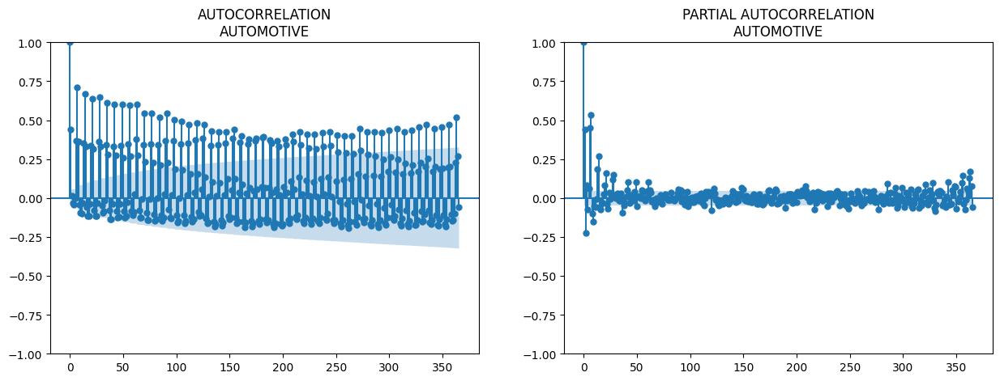

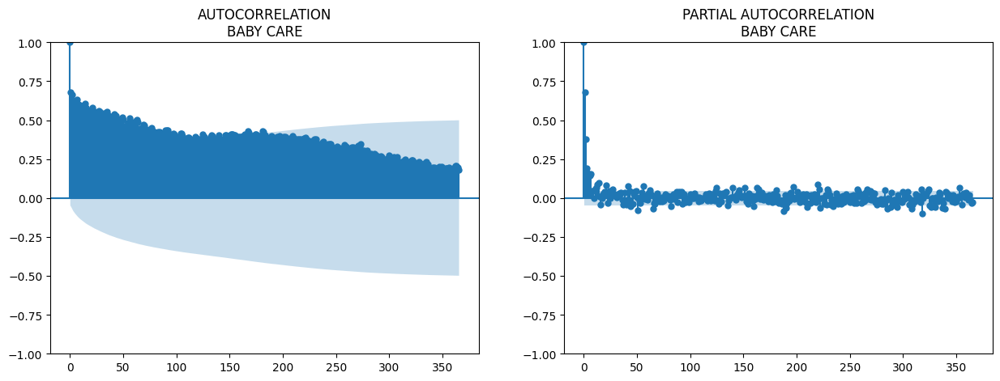

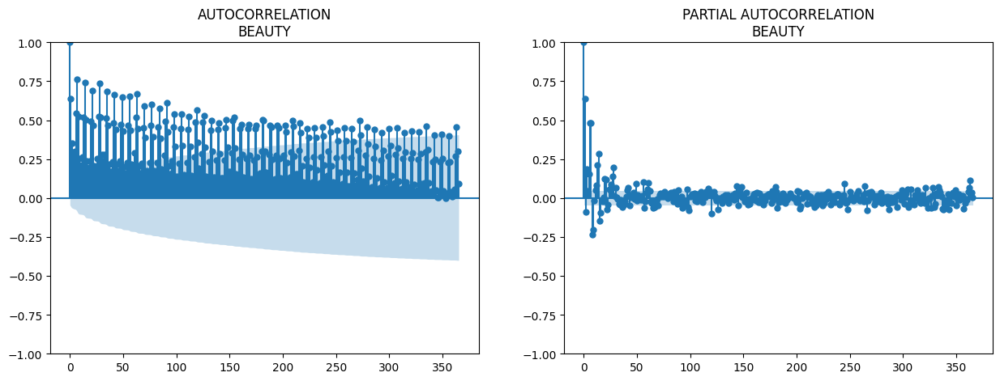

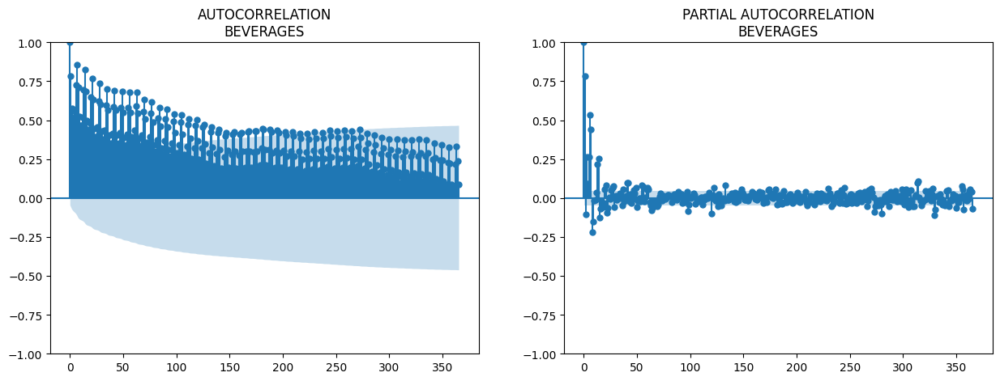

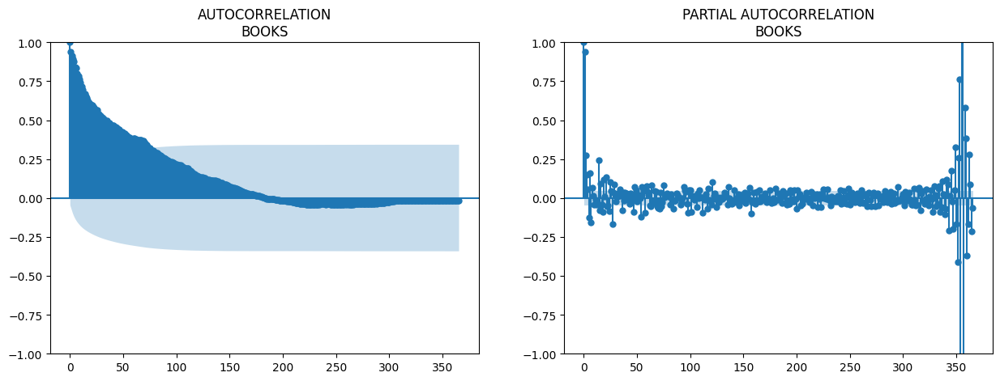

...

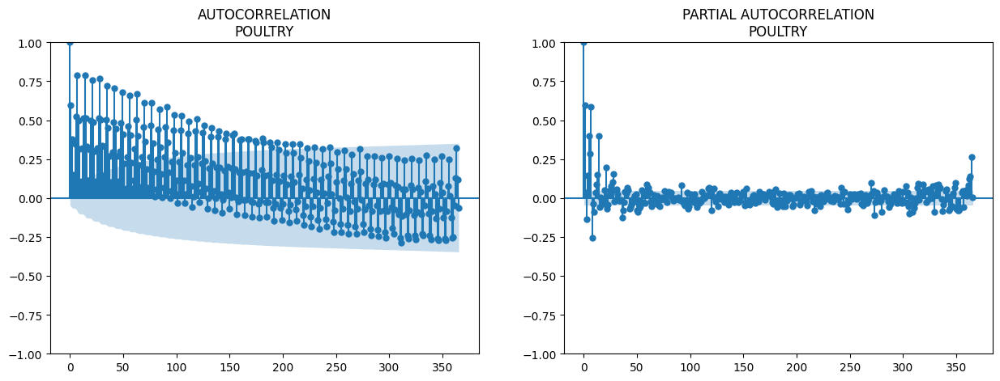

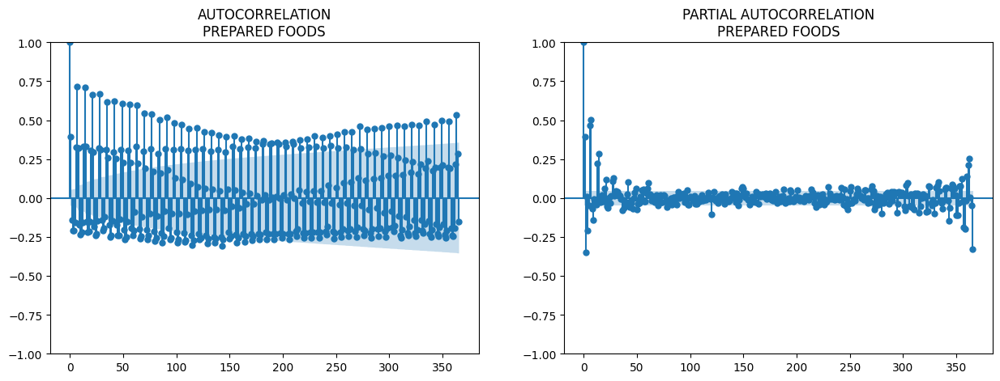

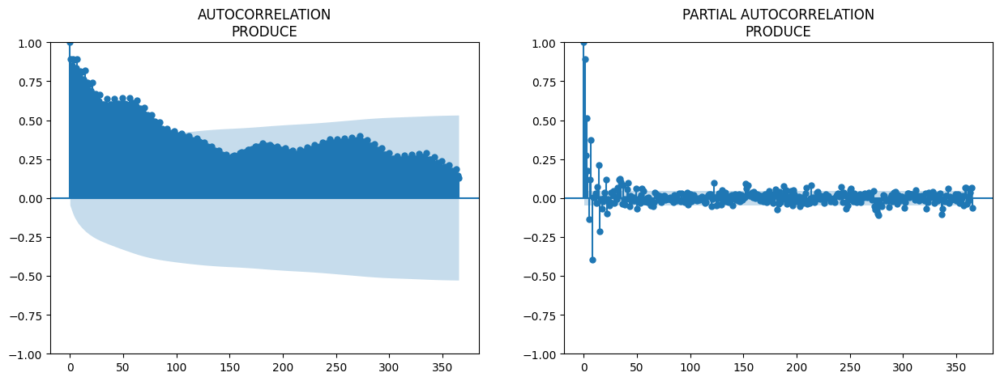

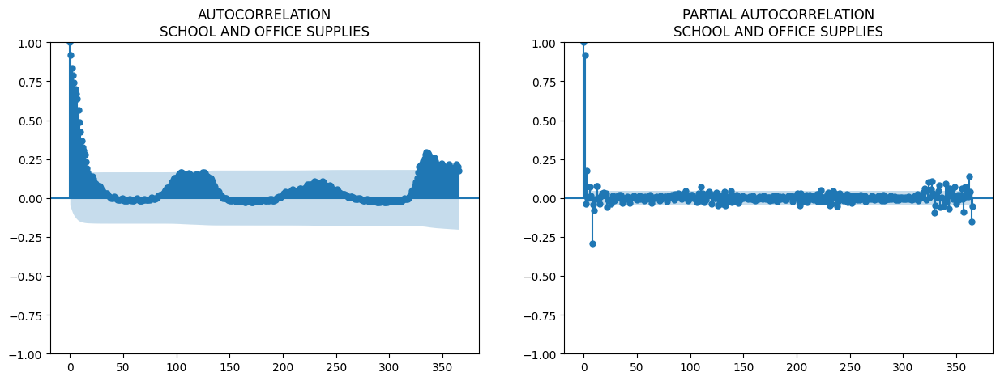

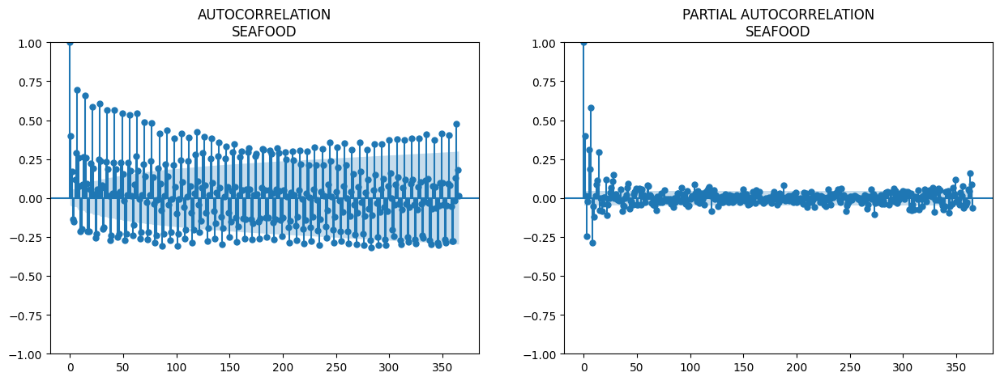

In [110]:

#a = d[d['store_nbr']==1].set_index('date')
a = d[(d.sales.notnull())].groupby(['date', 'family']
                                   ).sales.mean().reset_index().set_index('date')
for num, i in enumerate(a.family.unique()):
    try:
        fig, ax = plt.subplots(1, 2, figsize=(15, 5))
        temp = a[(a.family == i)]  # & (a.sales.notnull())
        sm.graphics.tsa.plot_acf(temp.sales, lags=365,
                                 ax=ax[0], title='AUTOCORRELATION\n' + i)
        sm.graphics.tsa.plot_pacf(
            temp.sales, lags=365, ax=ax[1], title='PARTIAL AUTOCORRELATION\n' + i)
    except:
        pass


We chose lags 16, 20, 30, 45, 365, 730 from PACF. I don't know that they will help us to improve the model but especially, 365th and 730th lags may be helpful. If you compare 2016 and 2017 years for sales, you can see that they are highly correlated.

In [111]:
a = d[d.year.isin([2016, 2017])].groupby(
    ['year', 'day_of_year']).sales.mean().reset_index()
px.line(a, x='day_of_year', y='sales', color='year',
        title='Average sales for 2016 and 2017')


# Moving Average

In [112]:
a = train.sort_values(['store_nbr', 'family', 'date'])
for i in [20, 30, 45, 60, 90, 120, 365, 730]:
    a['SMA'+str(i)+'_sales_lag16'] = a.groupby(['store_nbr', 'family']
                                               ).rolling(i).sales.mean().shift(16).values
    a['SMA'+str(i)+'_sales_lag30'] = a.groupby(['store_nbr', 'family']
                                               ).rolling(i).sales.mean().shift(30).values
    a['SMA'+str(i)+'_sales_lag60'] = a.groupby(['store_nbr', 'family']
                                               ).rolling(i).sales.mean().shift(60).values
print('Correlation')
a[['sales']+a.columns[a.columns.str.startswith('SMA')].tolist()].corr()


Correlation


,sales,SMA20_sales_lag16,SMA20_sales_lag30,SMA20_sales_lag60,SMA30_sales_lag16,SMA30_sales_lag30,SMA30_sales_lag60,SMA45_sales_lag16,SMA45_sales_lag30,SMA45_sales_lag60,...,SMA90_sales_lag60,SMA120_sales_lag16,SMA120_sales_lag30,SMA120_sales_lag60,SMA365_sales_lag16,SMA365_sales_lag30,SMA365_sales_lag60,SMA730_sales_lag16,SMA730_sales_lag30,SMA730_sales_lag60
sales,1.000000,0.906623,0.892198,0.871893,0.905947,0.893595,0.868868,0.907067,0.895384,0.868899,...,0.865685,0.903289,0.890164,0.864351,0.901928,0.891612,0.867263,0.906840,0.893062,0.863352
SMA20_sales_lag16,0.906623,1.000000,0.986197,0.949043,0.997407,0.983629,0.951804,0.992962,0.981536,0.952740,...,0.948504,0.981439,0.974366,0.946176,0.972298,0.970127,0.948531,0.976856,0.975994,0.948123
SMA20_sales_lag30,0.892198,0.986197,1.000000,0.962558,0.994439,0.997407,0.963730,0.996160,0.992962,0.965603,...,0.962423,0.985615,0.981439,0.959937,0.973631,0.972298,0.960445,0.976476,0.976856,0.963377
SMA20_sales_lag60,0.871893,0.949043,0.962558,1.000000,0.959387,0.976172,0.997407,0.977189,0.989062,0.992962,...,0.985856,0.988510,0.987888,0.981439,0.975190,0.974534,0.972298,0.976284,0.976438,0.976856
SMA30_sales_lag16,0.905947,0.997407,0.994439,0.959387,1.000000,0.992069,0.961854,0.997433,0.988939,0.963195,...,0.959696,0.986177,0.980079,0.957268,0.976121,0.974081,0.959423,0.978874,0.978228,0.960163
SMA30_sales_lag30,0.893595,0.983629,0.997407,0.976172,0.992069,1.000000,0.976451,0.997722,0.997433,0.977297,...,0.974494,0.989648,0.986177,0.971675,0.977314,0.976121,0.971517,0.978684,0.978874,0.975792
SMA30_sales_lag60,0.868868,0.951804,0.963730,0.997407,0.961854,0.976451,1.000000,0.978407,0.988016,0.997433,...,0.990336,0.991773,0.991387,0.986177,0.978877,0.978180,0.976121,0.978468,0.978638,0.978874
SMA45_sales_lag16,0.907067,0.992962,0.996160,0.977189,0.997433,0.997722,0.978407,1.000000,0.995901,0.979098,...,0.976119,0.991180,0.986352,0.973348,0.980279,0.978540,0.974974,0.980871,0.980363,0.977907
SMA45_sales_lag30,0.895384,0.981536,0.992962,0.989062,0.988939,0.997433,0.988016,0.995901,1.000000,0.986934,...,0.982745,0.993809,0.991180,0.979400,0.981349,0.980279,0.976468,0.980795,0.980871,0.979075
SMA45_sales_lag60,0.868899,0.952740,0.965603,0.992962,0.963195,0.977297,0.997433,0.979098,0.986934,1.000000,...,0.994709,0.994947,0.994981,0.991180,0.982790,0.982240,0.980279,0.980397,0.980694,0.980871


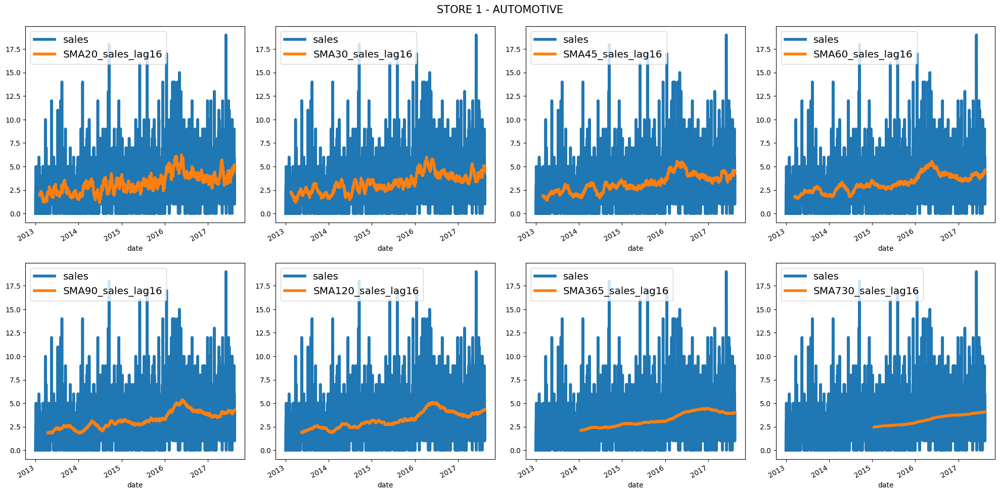

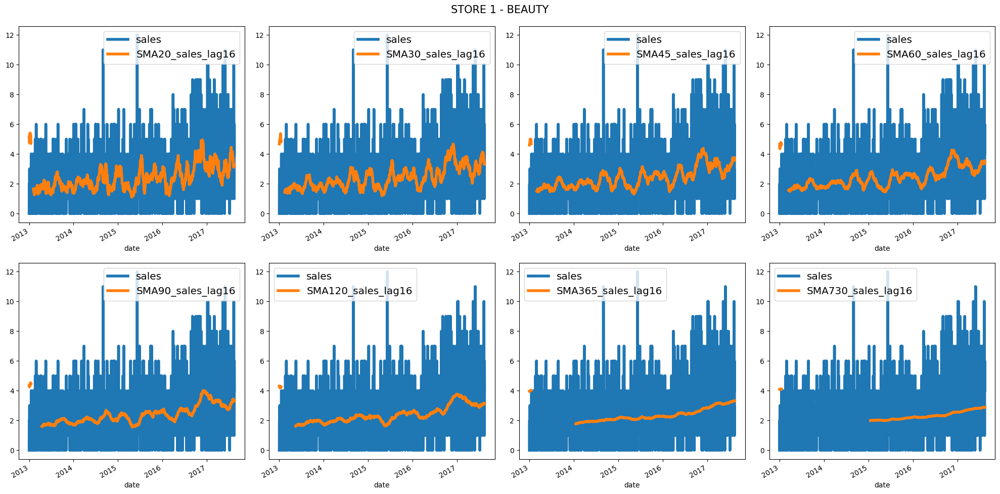

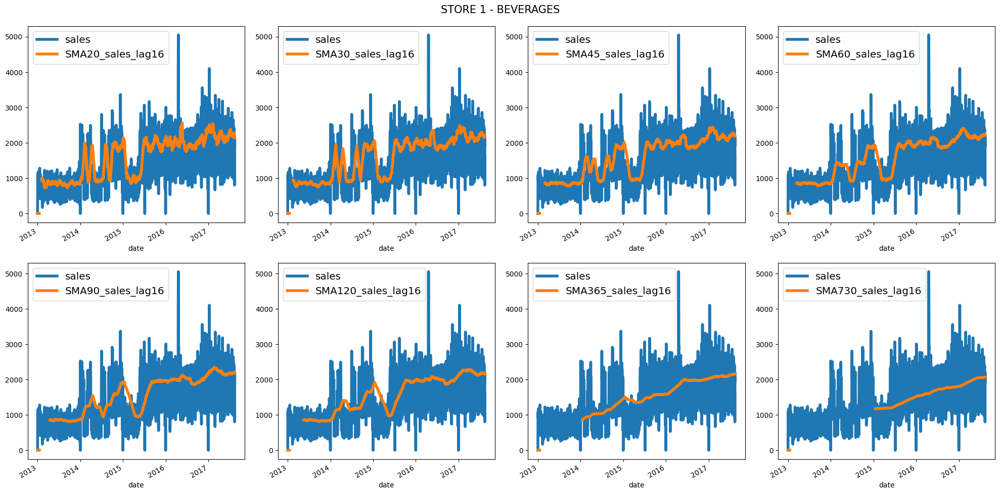

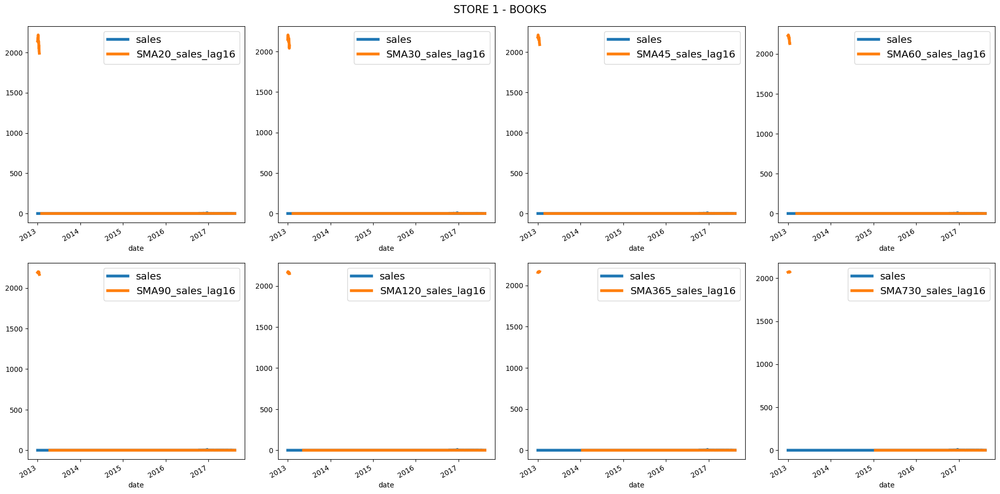

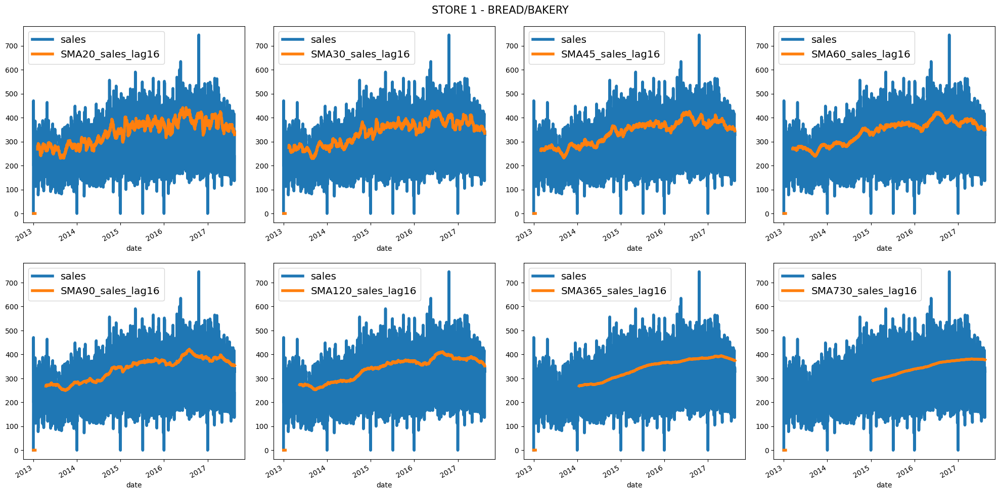

...

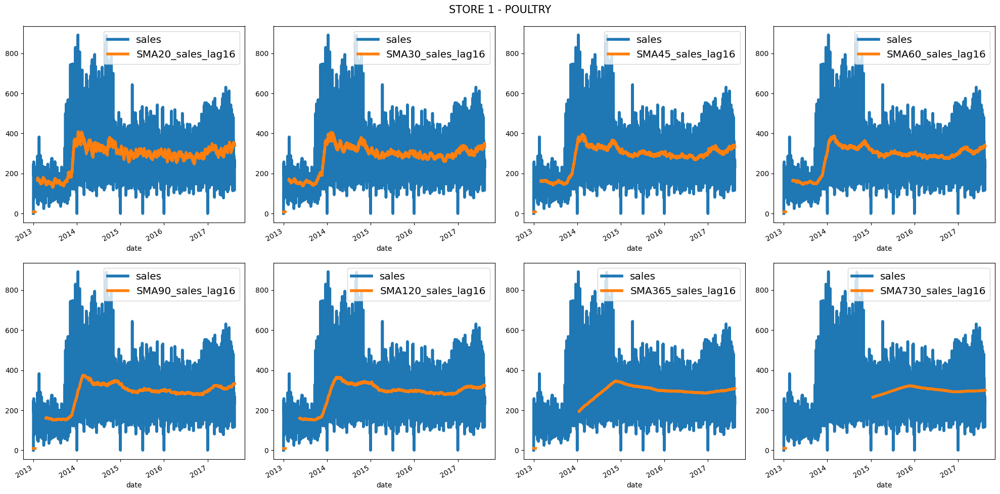

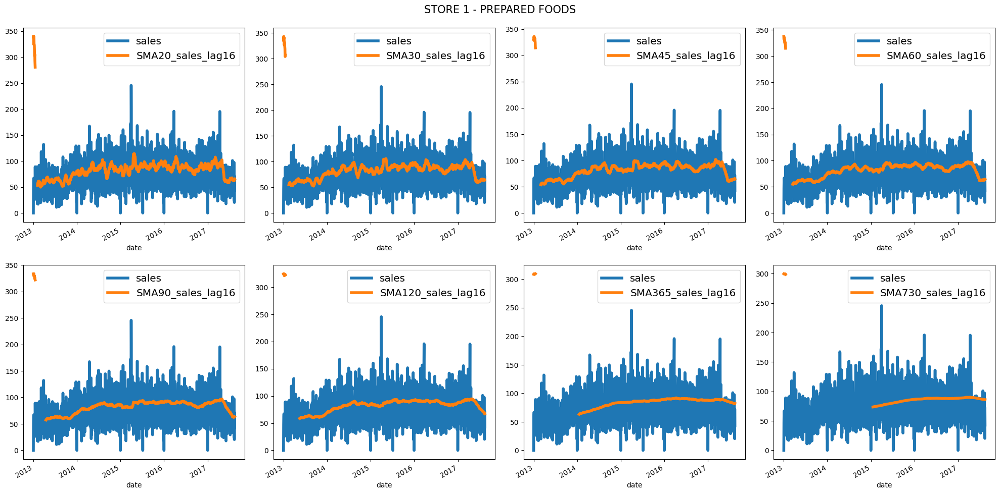

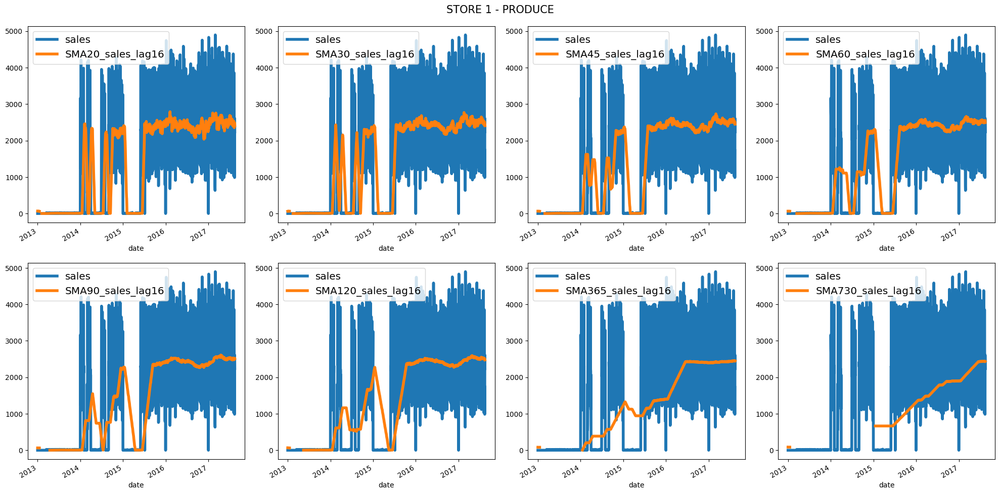

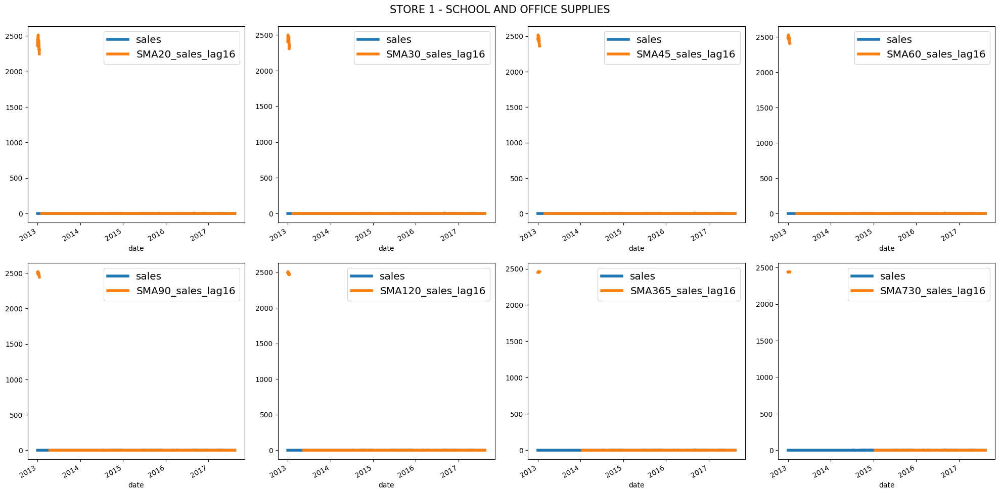

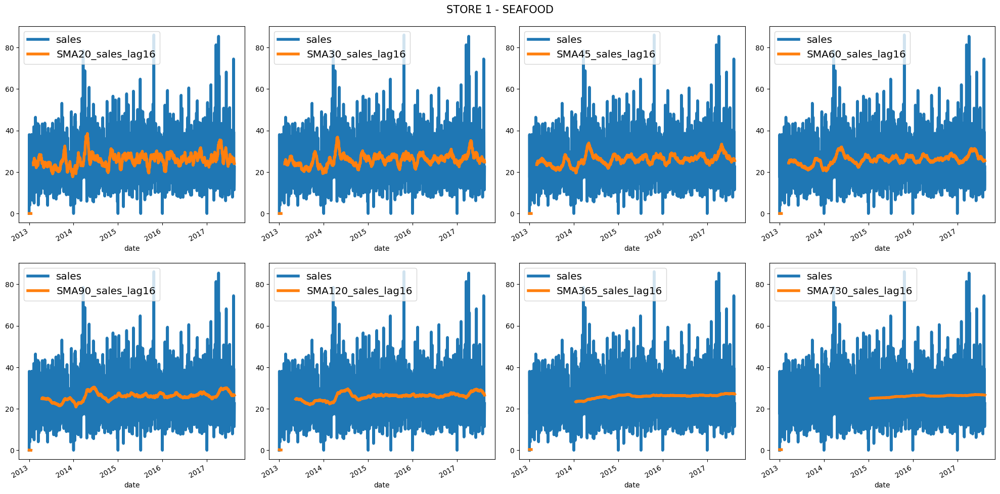

In [113]:
b = a[(a.store_nbr == 1)].set_index('date')
for i in b.family.unique():
    fig, ax = plt.subplots(2, 4, figsize=(20, 10))
    b[b.family == i][['sales', 'SMA20_sales_lag16']].plot(
        legend=True, ax=ax[0, 0], linewidth=4)
    b[b.family == i][['sales', 'SMA30_sales_lag16']].plot(
        legend=True, ax=ax[0, 1], linewidth=4)
    b[b.family == i][['sales', 'SMA45_sales_lag16']].plot(
        legend=True, ax=ax[0, 2], linewidth=4)
    b[b.family == i][['sales', 'SMA60_sales_lag16']].plot(
        legend=True, ax=ax[0, 3], linewidth=4)
    b[b.family == i][['sales', 'SMA90_sales_lag16']].plot(
        legend=True, ax=ax[1, 0], linewidth=4)
    b[b.family == i][['sales', 'SMA120_sales_lag16']].plot(
        legend=True, ax=ax[1, 1], linewidth=4)
    b[b.family == i][['sales', 'SMA365_sales_lag16']].plot(
        legend=True, ax=ax[1, 2], linewidth=4)
    b[b.family == i][['sales', 'SMA730_sales_lag16']].plot(
        legend=True, ax=ax[1, 3], linewidth=4)
    plt.suptitle('STORE 1 - '+i, fontsize=15)
    plt.tight_layout(pad=1.5)
    for j in range(0, 4):
        ax[0, j].legend(fontsize='x-large')
        ax[1, j].legend(fontsize='x-large')
    plt.show()


# Exponential Moving Average

In [114]:
def ewm_features(dataframe, alphas, lags):
    dataframe = dataframe.copy()
    for alpha in alphas:
        for lag in lags:
            dataframe['sales_ewm_alpha_' + str(alpha).replace('.', '') + '_lag_' + str(lag)] = \
                dataframe.groupby(['store_nbr', 'family'])['sales']. \
                transform(lambda x: x.shift(lag).ewm(alpha=alpha).mean())
    return dataframe


alphas = [0.95, 0.9, 0.8, 0.7, 0.5]
lags = [16, 30, 60, 90]

a = ewm_features(a, alphas, lags)


<AxesSubplot: title={'center': 'STORE 1 - GROCERY I'}, xlabel='date'>

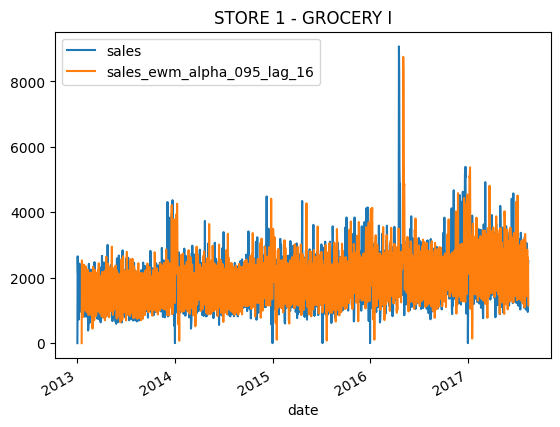

In [115]:
a[(a.store_nbr == 1) & (a.family == 'GROCERY I')].set_index('date')[
    ['sales', 'sales_ewm_alpha_095_lag_16']].plot(title='STORE 1 - GROCERY I')
